In [1]:
# -*- coding: utf-8 -*-
#
#  Copyright 2024 Technical University of Denmark
#  Authored by: Piotr Budzisz (DTU)
#
#  Licensed under the Apache License, Version 2.0 (the "License");
#  you may not use this file except in compliance with the License.
#  You may obtain a copy of the License at
#
#      http://www.apache.org/licenses/LICENSE-2.0
#
#  Unless required by applicable law or agreed to in writing, software
#  distributed under the License is distributed on an "AS IS" BASIS,
#  WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
#  See the License for the specific language governing permissions and
#  limitations under the License.
#
#  The dataset and files mentioned in the notebook belong to the CFU (Center for Fast Ultrasound Imaging) at DTU (Technical University of Denmark).
#
#  Note: The following code has been created for the purpose of a master's thesis by Piotr Budzisz titled
#  "Computational reduction of reconstruction artifacts in stitching-based biomedical computed tomography,"
#  written at the Technical University of Denmark. The file is based on and reuses parts and descriptions
#  from the Core Imaging Library notebooks created by :
#
#                   Jakob S. Jørgensen (DTU)
#                   Gemma Fardell (UKRI-STFC)
#                   Laura Murgatroyd (UKRI-STFC)
#
#  which can be found in the GitHub repository (https://github.com/TomographicImaging/CIL-Demos).
#  Copyright 2021 - 2022 United Kingdom Research and Innovation
#  Copyright 2021 - 2022 The University of Manchester
#  Copyright 2021 - 2022 Technical University of Denmark
#    

# Phase 2

## Iterative reconstruction in CIL

### The case is a 2D parallel-beam synchrotron slice.



In [1]:
# CIL core components needed
from cil.framework import ImageGeometry, AcquisitionGeometry, BlockDataContainer

# CIL optimisation algorithms and linear operators
from cil.optimisation.algorithms import CGLS
from cil.optimisation.operators import BlockOperator, GradientOperator, IdentityOperator, FiniteDifferenceOperator

# CIL example synthetic test image
from cil.utilities.dataexample import SHAPES

# CIL display tools
from cil.utilities.display import show2D, show1D, show_geometry

# Forward/backprojector from CIL ASTRA plugin
from cil.plugins.astra import ProjectionOperator

# For shepp-logan test image in CIL tomophantom plugin
from cil.plugins import TomoPhantom as cilTomoPhantom

# Third-party imports
import numpy as np    
import matplotlib.pyplot as plt


from cil.framework import ImageData, ImageGeometry
from cil.framework import AcquisitionGeometry, AcquisitionData
from cil.plugins.astra.processors import FBP
from cil.processors import CentreOfRotationCorrector, Slicer, TransmissionAbsorptionConverter, Normaliser, Padder
import numpy as np
import scipy.io
import os


# apply circle mask 
from numpy import arange, meshgrid, isscalar, ndarray, pi, roll

In [2]:
# circle mask
offset = 0

siz = 2048
if siz % 2:
    rang = arange(-siz / 2 + 1, siz / 2 + 1)
else:
    rang = arange(-siz / 2,siz / 2)
x,y = meshgrid(rang,rang)
z = x ** 2 + y ** 2
a = (z < (siz / 2 - abs(offset)) ** 2)

In [3]:
# constants
# set the backend for FBP and the ProjectionOperator
device = 'gpu'
# set up default colour map for visualisation
cmap = "gray"
ca1 = -0.001
ca2 = 0.002

In [6]:
# load elletra slice

In [7]:
# Directory containing data and images
im_dir_1 = "/dtu/cfu/data/userdata15/panum_rats/rat_77/elettra_ct_data/recons/rat_77_full_Z2.35_X0.67_Y1.83/slices/"
im_dir_2 = "/dtu/cfu/data/userdata18/s220464/storage/folder_recons/"

im_name_1 = "slice_1023.tif"
im_name_2 = "slice_1023.tif"

from skimage import color, io, measure, img_as_ubyte

# Read the image.
# Here the directory and the image name is concatenated
# by "+" to give the full path to the image.
im_1 = io.imread(im_dir_1 + im_name_1)
im_2 = io.imread(im_dir_2 + im_name_2)

elletra = im_1
#elletra.set_labels(['horizontal_x','horizontal_y'])

In [8]:
# loading a slice and both geometries

In [4]:
# load slice
datapath = "/dtu/cfu/data/userdata18/s220464/storage/PHASE_1/"
filename = "slice3_1023_data.mat"  
all_data = scipy.io.loadmat(os.path.join(datapath,filename))
projs = all_data['X_proj'].astype(np.float32)

ag = AcquisitionGeometry.create_Parallel2D()  \
         .set_panel(num_pixels=(2048))        \
         .set_angles(angles=np.linspace(0,180,1800,endpoint=False))

ag.set_labels(['horizontal','angle'])
print(ag.dimension_labels)
data = AcquisitionData(projs, geometry=ag, deep_copy=False)

data.reorder('astra')
ig = ag.get_ImageGeometry()

A = ProjectionOperator(ig, ag, device)
padsize = 512
data_pad_512 = Padder.edge(pad_width={'horizontal': padsize})(data)

ag_512 = data_pad_512.geometry
ig_512 = ag_512.get_ImageGeometry()
A_512 = ProjectionOperator(ig_512, ag_512, device)

('horizontal', 'angle')


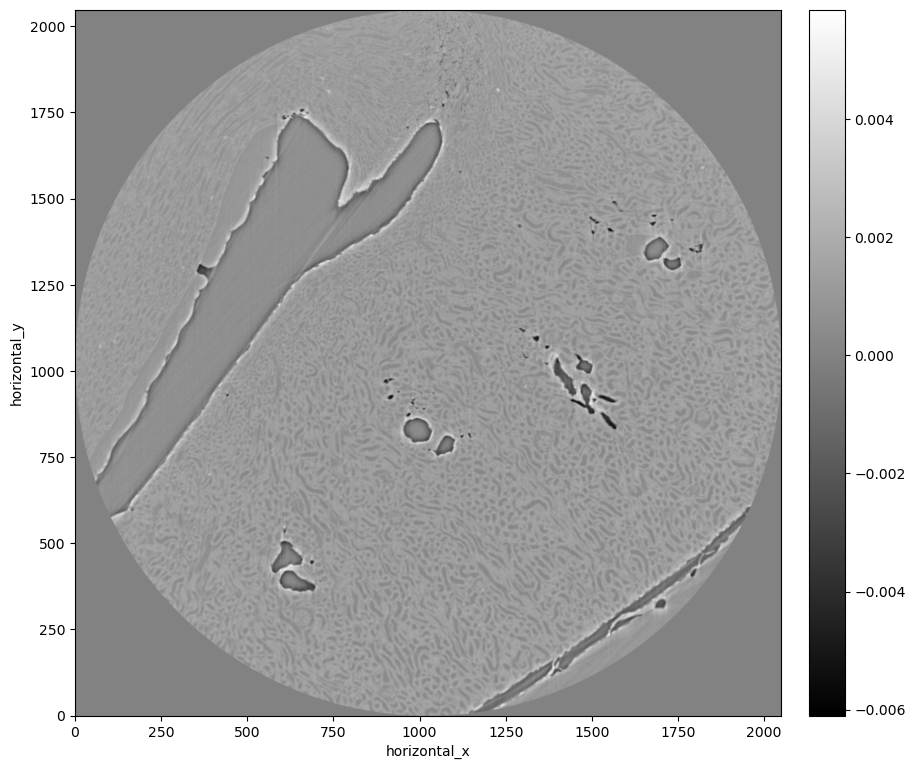

In [10]:
fbp = FBP(ig, ag_512, device)
# run on the AcquisitionData
recon_fbp_512 = fbp(data_pad_512) * a
show2D(recon_fbp_512)


# FBP needs original ig (reconstruction volume) with 2048x2048 dimensions!!!

In [13]:
fbp = FBP(ig, ag, device)
# run on the AcquisitionData
recon_fbp = fbp(data) 

In [14]:
fbp = FBP(ig, ag_512, device)
# run on the AcquisitionData
recon_fbp_512 = fbp(data_pad_512) 


In [15]:
fbp = FBP(ig_512, ag_512, device)
# run on the AcquisitionData
recon_fbp_512_2 = fbp(data_pad_512) 

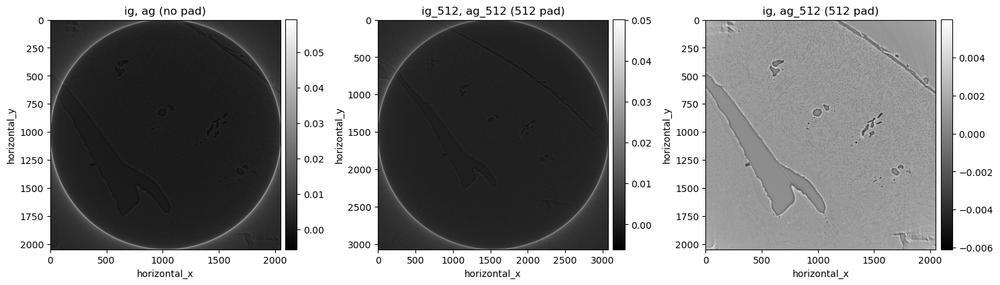

In [16]:
show2D([recon_fbp, recon_fbp_512_2, recon_fbp_512], ['ig, ag (no pad)', 'ig_512, ag_512 (512 pad)', 'ig, ag_512 (512 pad)'], \
       cmap=cmap, num_cols=3, size=(15,10), origin='upper-left')

In [17]:
## FBP vs CGLS

In [5]:
# initial estimate - zero array in this case 
initial = ig.allocate(0)

# setup CGLS
cgls = CGLS(initial=initial, 
            operator=A, 
            data=data,
            max_iteration = 10,
            update_objective_interval = 1 )

In [6]:
# run N interations
cgls.run(5, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0         10         0.000          6.71853e+07
        1         10         0.328          3.31970e+06
        2         10         0.324          1.12365e+06
        3         10         0.321          6.32515e+05
        4         10         0.320          5.10026e+05
        5         10         0.320          3.83439e+05
-------------------------------------------------------
        5         10         0.320          3.83439e+05
Stop criterion has been reached.



In [7]:
# initial estimate - zero array in this case 
initial = ig_512.allocate(0)

# setup CGLS
cgls_padded = CGLS(initial=initial, 
            operator=A_512, 
            data=data_pad_512,
            max_iteration = 10,
            update_objective_interval = 1 )

In [21]:
# run N interations
cgls_padded.run(5, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0         10         0.000          9.94488e+07
        1         10         0.650          4.87100e+06
        2         10         0.649          1.70297e+06
        3         10         0.649          1.03393e+06
        4         10         0.649          7.97365e+05
        5         10         0.651          6.13756e+05
-------------------------------------------------------
        5         10         0.651          6.13756e+05
Stop criterion has been reached.



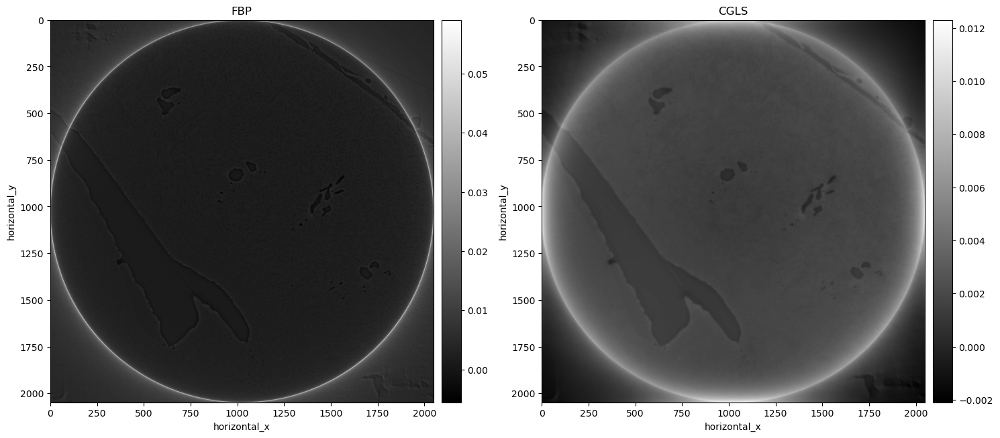

In [22]:
# get and visualise the results
recon_cgls = cgls.solution

show2D([recon_fbp, recon_cgls], ['FBP', 'CGLS'], \
       cmap=cmap, num_cols=2, size=(15,10), origin='upper-left')

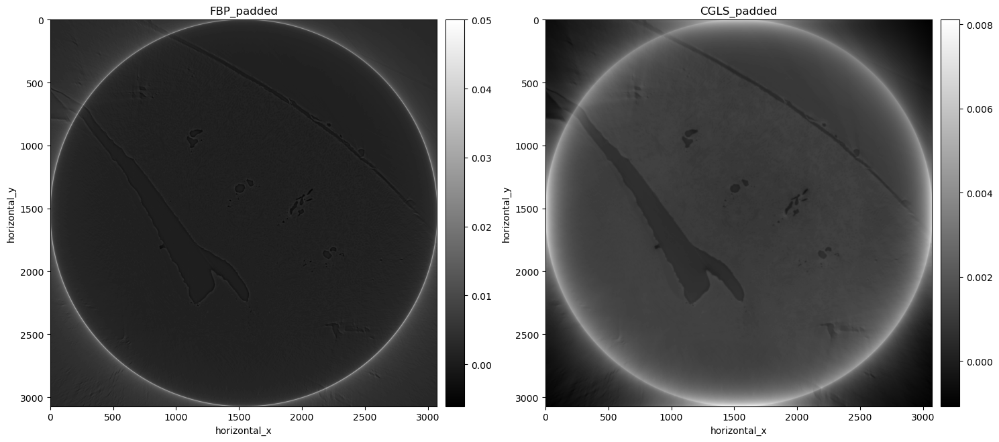

In [24]:
# get and visualise the results
recon_cgls_padded = cgls_padded.solution

show2D([recon_fbp_512_2, recon_cgls_padded], ['FBP_padded', 'CGLS_padded'], \
       cmap=cmap, num_cols=2, size=(15,10), origin='upper-left')

In [25]:
# FBP needs original ig (reconstruction volume) with 2048x2048 dimensions!!!  

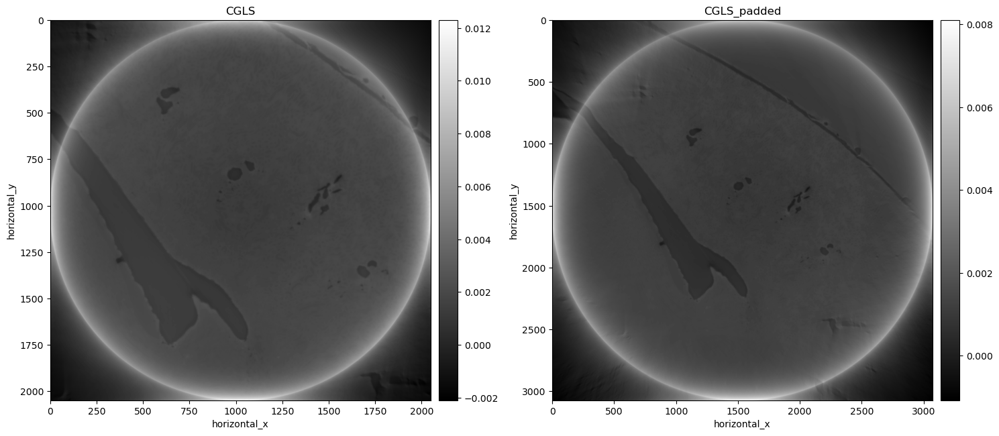

In [26]:
show2D([recon_cgls, recon_cgls_padded], ['CGLS', 'CGLS_padded'], \
       cmap=cmap, num_cols=2, size=(15,10), origin='upper-left')

In [27]:
# we will use padded cgls recon but cropped and with circular mask

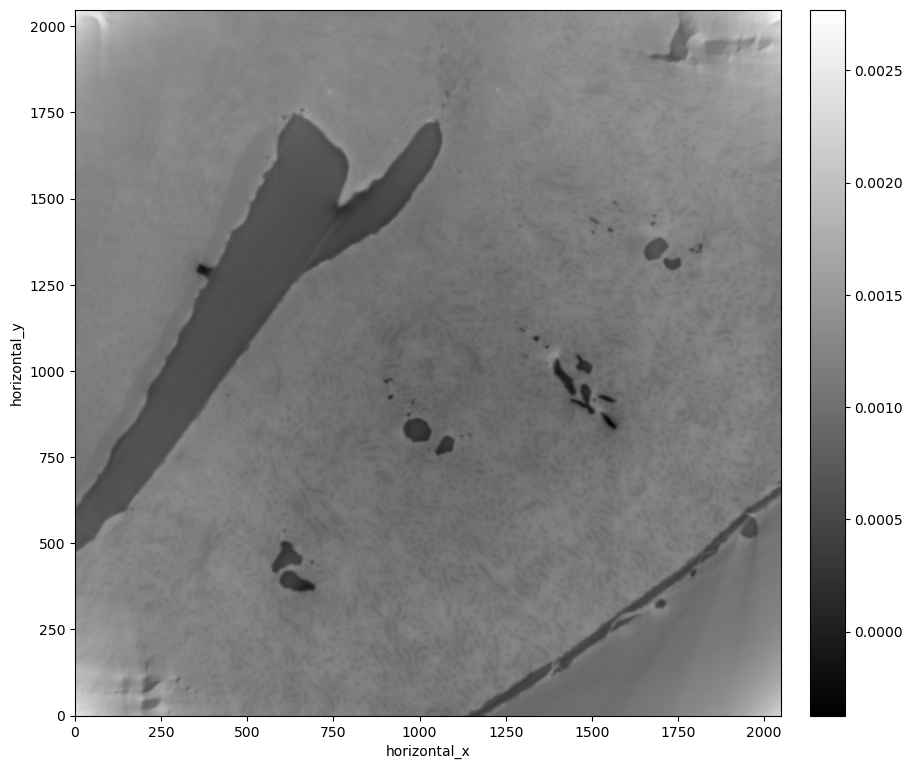

In [28]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(recon_cgls_padded)
im_crop.shape
show2D(im_crop)

In [29]:
recon_cgls_mask = recon_cgls * a

In [30]:
recon_cgls_mask_pad = im_crop * a

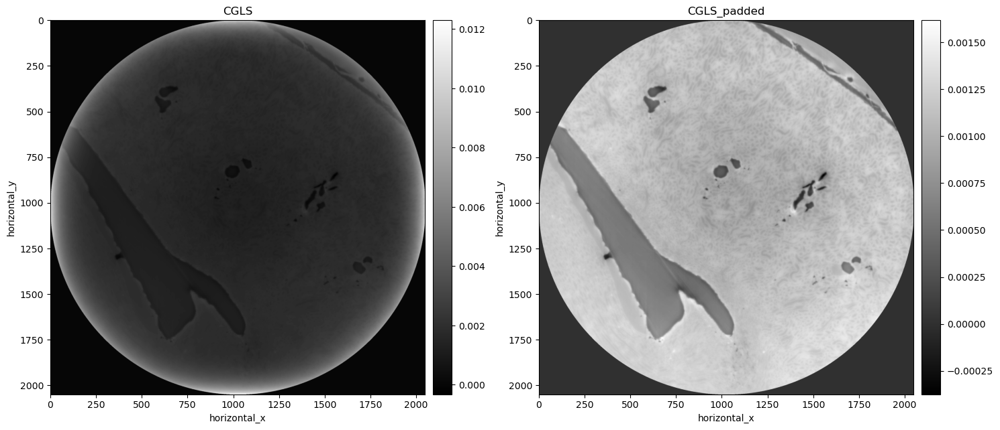

In [31]:
show2D([recon_cgls_mask, recon_cgls_mask_pad], ['CGLS', 'CGLS_padded'], \
       cmap=cmap, num_cols=2, size=(15,10), origin='upper-left')

In [8]:
initial = ig_512.allocate(0)

# setup CGLS
myCGLS = CGLS(initial=initial, 
            operator=A_512, 
            data=data_pad_512,
            max_iteration = 1000,
            update_objective_interval = 10 )

In [9]:
# run N interations
myCGLS.run(5, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0       1000         0.000          9.94488e+07
-------------------------------------------------------
        5       1000         0.655                     
Stop criterion has been reached.



In [10]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_5 = im_crop * a

In [11]:
# run N interations
myCGLS.run(5, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        5       1000         0.655                     
       10       1000         0.668          4.34553e+05
-------------------------------------------------------
       10       1000         0.668          4.34553e+05
Stop criterion has been reached.



In [12]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_10 = im_crop * a

In [13]:
# run N interations
myCGLS.run(15, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       10       1000         0.668          4.34553e+05
       20       1000         0.668          3.82441e+05
-------------------------------------------------------
       25       1000         0.664                     
Stop criterion has been reached.



In [14]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_25 = im_crop * a

In [15]:
# run N interations
myCGLS.run(25, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       25       1000         0.664                     
       30       1000         0.665          3.71492e+05
       40       1000         0.667          3.67177e+05
       50       1000         0.667          3.64605e+05
-------------------------------------------------------
       50       1000         0.667          3.64605e+05
Stop criterion has been reached.



In [17]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_50 = im_crop * a

In [18]:
# run N interations
myCGLS.run(25, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       50       1000         0.667          3.64605e+05
       60       1000         0.667          3.62869e+05
       70       1000         0.664          3.61743e+05
-------------------------------------------------------
       75       1000         0.665                     
Stop criterion has been reached.



In [19]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_75 = im_crop * a

In [42]:
# run N interations
myCGLS.run(25, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       50       1000         0.648          3.64605e+05
       60       1000         0.648          3.62869e+05
       70       1000         0.648          3.61743e+05
       80       1000         0.648          3.60779e+05
       90       1000         0.648          3.60009e+05
      100       1000         0.647          3.59316e+05
-------------------------------------------------------
      100       1000         0.647          3.59316e+05
Stop criterion has been reached.



In [43]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_100 = im_crop * a

In [44]:
# run N interations
myCGLS.run(100, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      100       1000         0.647          3.59316e+05
      110       1000         0.648          3.58720e+05
      120       1000         0.648          3.58163e+05
      130       1000         0.648          3.57691e+05
      140       1000         0.649          3.57194e+05
      150       1000         0.649          3.56669e+05
      160       1000         0.649          3.56134e+05
      170       1000         0.649          3.55617e+05
      180       1000         0.649          3.55084e+05
      190       1000         0.649          3.54602e+05
      200       1000         0.649          3.54128e+05
-------------------------------------------------------
      200       1000         0.649          3.54128e+05
Stop criterion has been reached.



In [45]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_200 = im_crop * a

In [46]:
# get and visualise the results
recon_cgls_padded = myCGLS.solution

In [47]:
# run N interations
myCGLS.run(100, verbose=True)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      200       1000         0.649          3.54128e+05
      210       1000         0.649          3.53590e+05
      220       1000         0.649          3.53033e+05
      230       1000         0.649          3.52395e+05
      240       1000         0.649          3.51762e+05
      250       1000         0.649          3.51032e+05
      260       1000         0.649          3.50324e+05
      270       1000         0.649          3.49656e+05
      280       1000         0.649          3.48939e+05
      290       1000         0.649          3.48147e+05
      300       1000         0.649          3.47347e+05
-------------------------------------------------------
      300       1000         0.649          3.47347e+05
Stop criterion has been reached.



In [48]:
#crop, mask, save

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myCGLS.solution)
#im_crop.shape

#show2D(im_crop)
recon_cgls_300 = im_crop * a

In [49]:
#crop and mask

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(recon_cgls_padded)
#im_crop.shape

#show2D(im_crop)
recon_cgls_mask_pad = im_crop * a

In [50]:
recon_fbp_mask_pad = recon_fbp_512 * a

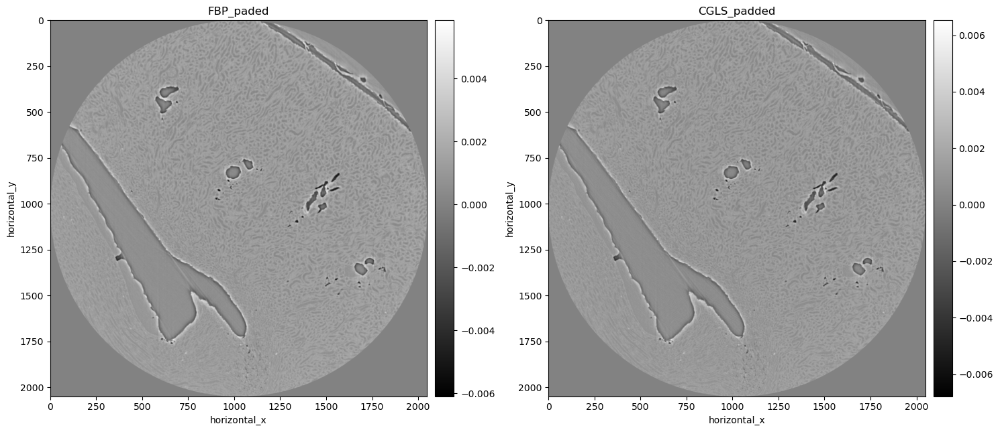

In [51]:
show2D([recon_fbp_mask_pad, recon_cgls_mask_pad], ['FBP_paded', 'CGLS_padded'], \
       cmap=cmap, num_cols=2, size=(15,10), origin='upper-left')

In [52]:
# compare, apply a fix intensity range and do some line profiles maybe

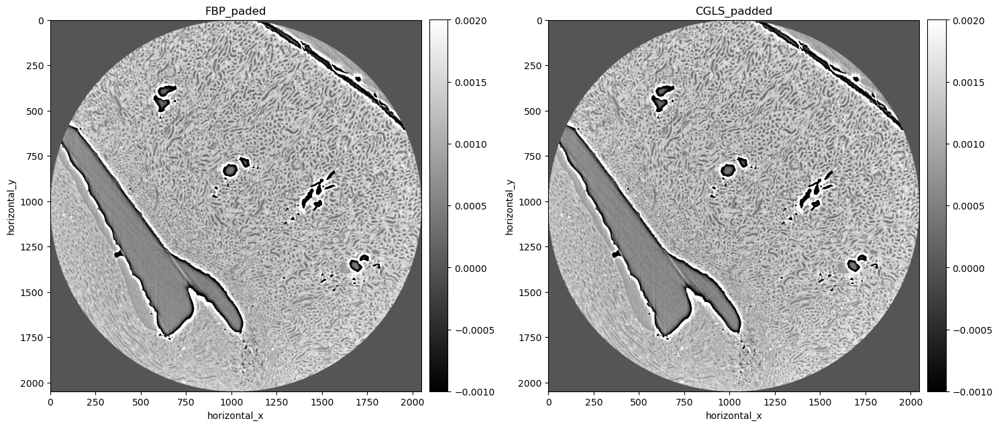

In [53]:
ca1 = -0.001
ca2 = 0.002

show2D([recon_fbp_mask_pad, recon_cgls_mask_pad], ['FBP_paded', 'CGLS_padded'], \
       cmap=cmap, fix_range=(ca1,ca2), num_cols=2, size=(15,10), origin='upper-left')

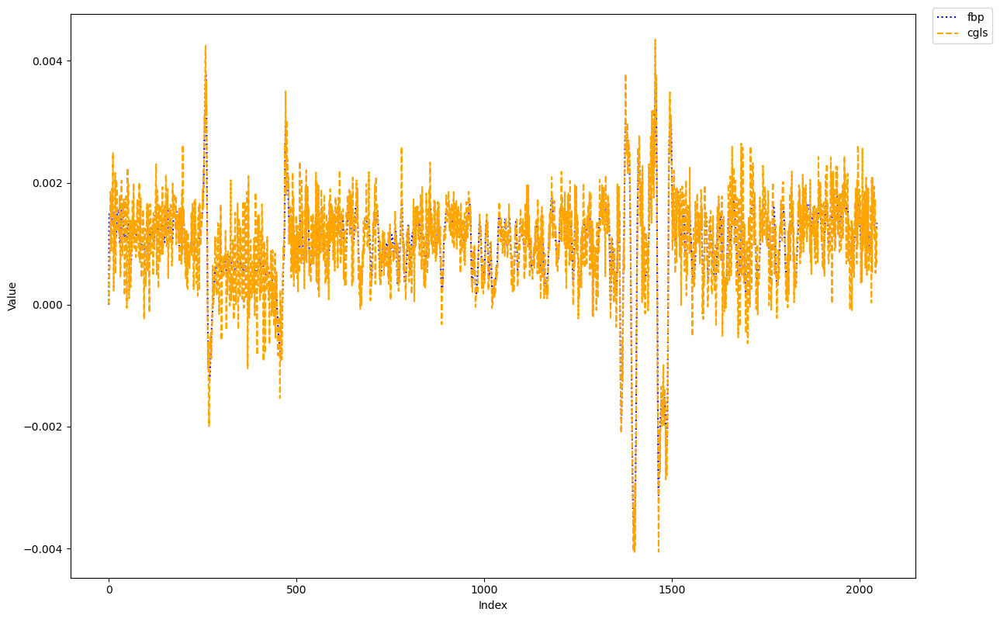

In [54]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_cgls_mask_pad],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp','cgls'],
      line_colours=['blue','orange'],
      line_styles=['dotted','dashed'],
      size=(12,8))

In [55]:
# get and visualise the results
recon_cgls_padded = myCGLS.solution

In [56]:
#crop and mask

im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(recon_cgls_padded)
#im_crop.shape

#show2D(im_crop)
recon_cgls_mask_pad = im_crop * a

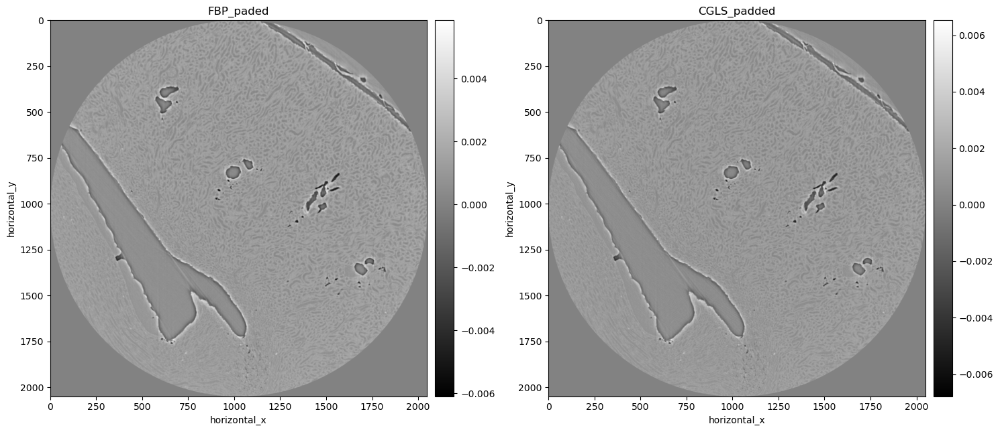

In [57]:
show2D([recon_fbp_mask_pad, recon_cgls_mask_pad], ['FBP_paded', 'CGLS_padded'], \
       cmap=cmap, num_cols=2, size=(15,10), origin='upper-left')

In [58]:
#more iterations cuz it to be darker

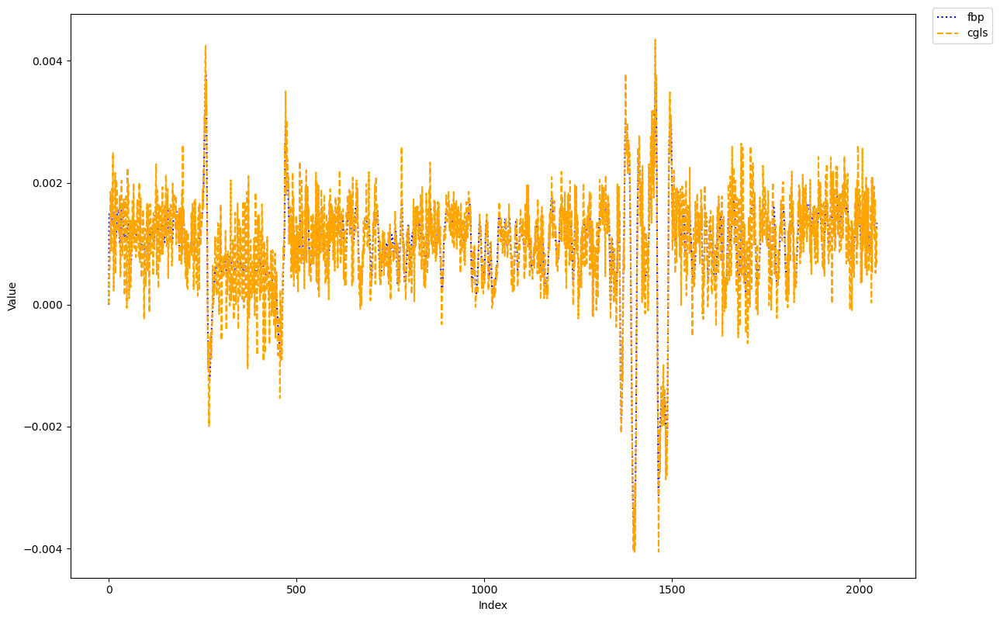

In [59]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_cgls_mask_pad],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp','cgls'],
      line_colours=['blue','orange'],
      line_styles=['dotted','dashed'],
      size=(12,8))

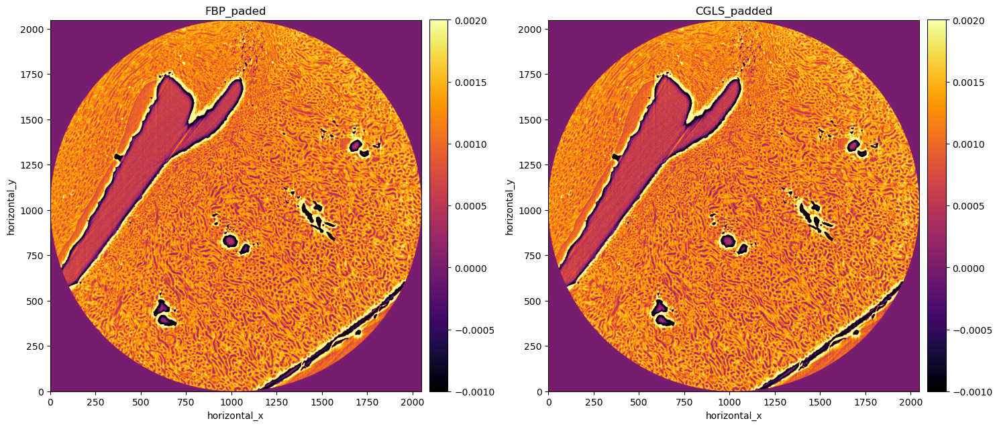

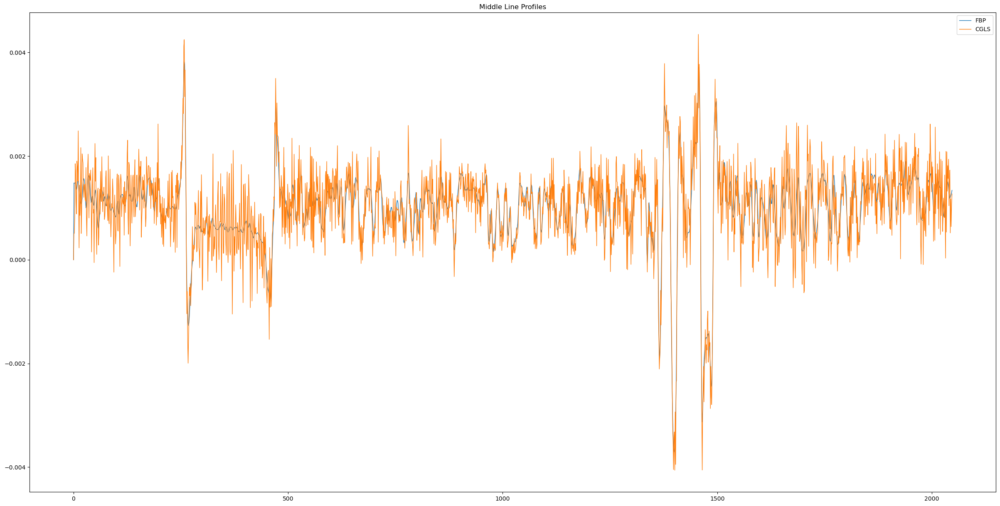

In [60]:
show2D([recon_fbp_mask_pad, recon_cgls_mask_pad], title = ['FBP_paded', 'CGLS_padded'], cmap = 'inferno', num_cols=2, fix_range=(ca1,ca2))
N = 2048
# Plot middle line profile
plt.figure(figsize=(30,15))
plt.plot(recon_fbp_mask_pad.get_slice(horizontal_y = int(N/2)).as_array(), label = 'FBP', linewidth=1, linestyle='solid')
plt.plot(recon_cgls_mask_pad.get_slice(horizontal_y = int(N/2)).as_array(), label = 'CGLS', linewidth=1, linestyle='solid')

plt.legend()
plt.title('Middle Line Profiles')
plt.show()

## SIRT

In [66]:
from cil.optimisation.algorithms import SIRT

In [67]:
from cil.optimisation.functions import IndicatorBox

In [68]:
x0 = ig_512.allocate()
constraint = IndicatorBox(lower=0)

sirt = SIRT(initial=x0, operator=A_512, data=data_pad_512, constraint=constraint, max_iteration=1000)
sirt.update_objective_interval = 10
sirt.run(5)



     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0       1000         0.000          9.94488e+07
-------------------------------------------------------
        5       1000         0.665                     
Stop criterion has been reached.



In [69]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_5 = recon_sirt_crop * a

In [70]:
sirt.run(5)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        5       1000         0.665                     
       10       1000         0.665          2.31489e-01
-------------------------------------------------------
       10       1000         0.665          2.31489e-01
Stop criterion has been reached.



In [71]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_10 = recon_sirt_crop * a

In [72]:
sirt.run(15)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       10       1000         0.665          2.31489e-01
       20       1000         0.666          1.40945e-01
-------------------------------------------------------
       25       1000         0.665                     
Stop criterion has been reached.



In [73]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_25 = recon_sirt_crop * a

In [74]:
sirt.run(25)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       25       1000         0.665                     
       30       1000         0.665          1.12870e-01
       40       1000         0.664          9.91377e-02
       50       1000         0.663          9.09525e-02
-------------------------------------------------------
       50       1000         0.663          9.09525e-02
Stop criterion has been reached.



In [75]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_50 = recon_sirt_crop * a

In [76]:
sirt.run(50)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       50       1000         0.663          9.09525e-02
       60       1000         0.663          8.55088e-02
       70       1000         0.663          8.16295e-02
       80       1000         0.663          7.87272e-02
       90       1000         0.662          7.64792e-02
      100       1000         0.663          7.46861e-02
-------------------------------------------------------
      100       1000         0.663          7.46861e-02
Stop criterion has been reached.



In [77]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_100 = recon_sirt_crop * a

In [78]:
sirt.run(100)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      100       1000         0.663          7.46861e-02
      110       1000         0.663          7.32206e-02
      120       1000         0.663          7.20001e-02
      130       1000         0.662          7.09684e-02
      140       1000         0.662          7.00836e-02
      150       1000         0.663          6.93161e-02
      160       1000         0.663          6.86436e-02
      170       1000         0.663          6.80492e-02
      180       1000         0.663          6.75201e-02
      190       1000         0.663          6.70460e-02
      200       1000         0.663          6.66188e-02
-------------------------------------------------------
      200       1000         0.663          6.66188e-02
Stop criterion has been reached.



In [79]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_200 = recon_sirt_crop * a

In [80]:
sirt.run(100)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      200       1000         0.663          6.66188e-02
      210       1000         0.663          6.62319e-02
      220       1000         0.664          6.58801e-02
      230       1000         0.664          6.55588e-02
      240       1000         0.664          6.52641e-02
      250       1000         0.664          6.49928e-02
      260       1000         0.664          6.47421e-02
      270       1000         0.664          6.45098e-02
      280       1000         0.664          6.42940e-02
      290       1000         0.664          6.40930e-02
      300       1000         0.665          6.39053e-02
-------------------------------------------------------
      300       1000         0.665          6.39053e-02
Stop criterion has been reached.



In [81]:
recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(sirt.solution)

recon_sirt_300 = recon_sirt_crop * a

In [82]:
recon_sirt = sirt.solution

recon_sirt_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(recon_sirt)

recon_sirt_mask = recon_sirt_crop * a

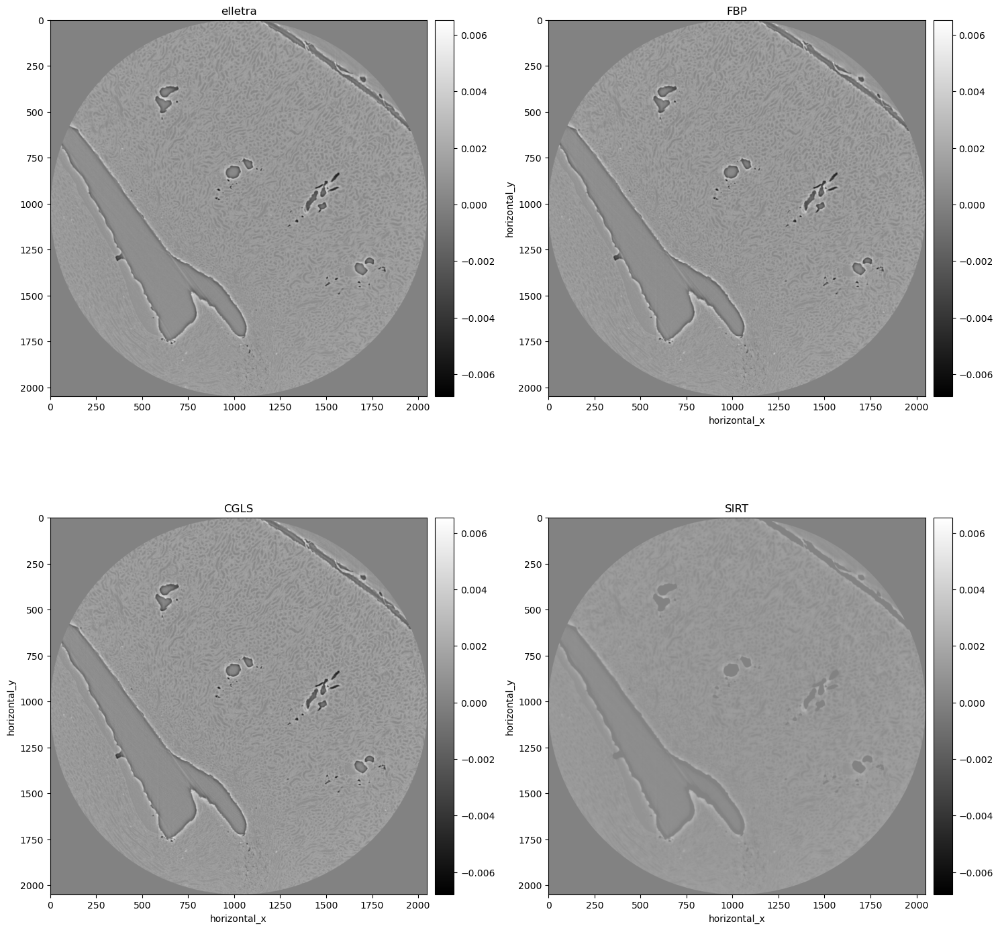

In [83]:
show2D([elletra, recon_fbp_mask_pad, recon_cgls_mask_pad, recon_sirt_mask], \
       ['elletra', 'FBP', 'CGLS', 'SIRT'], \
       cmap=cmap, num_cols=2, size=(15,15), origin='upper-left', fix_range=True)

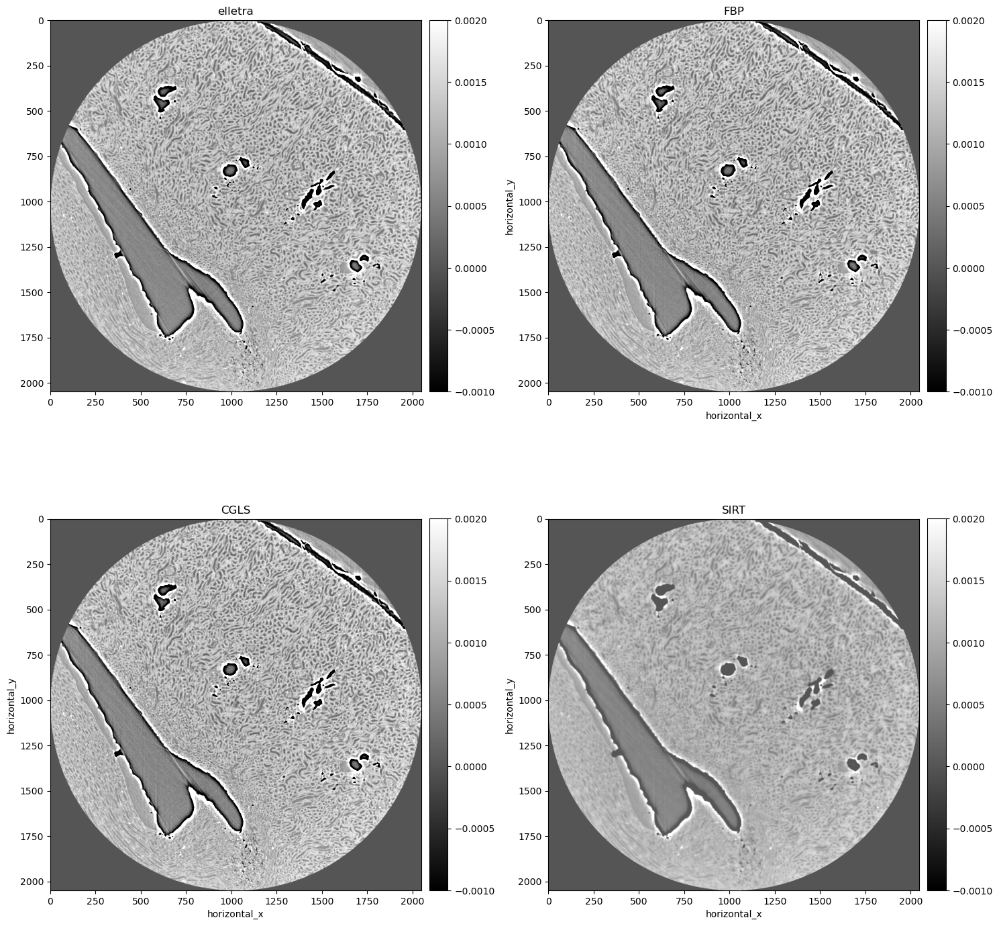

In [84]:
show2D([elletra, recon_fbp_mask_pad, recon_cgls_mask_pad, recon_sirt_mask], \
       ['elletra', 'FBP', 'CGLS', 'SIRT'], \
       cmap=cmap, num_cols=2, size=(15,15), origin='upper-left', fix_range=(-0.001, 0.002))

## Use FISTA to solve a Least Squares problem with a non-negativity constraint

In [85]:
from cil.optimisation.algorithms import GD, FISTA, PDHG
from cil.optimisation.operators import BlockOperator, GradientOperator,\
                                       GradientOperator

In [86]:
from cil.optimisation.functions import IndicatorBox, MixedL21Norm, L2NormSquared, \
                                       BlockFunction, L1Norm, LeastSquares, \
                                       OperatorCompositionFunction, TotalVariation, \
                                       ZeroFunction

In [87]:
b = data_pad_512

In [88]:
x0 = ig_512.allocate(0.0)

In [89]:
F = LeastSquares(A_512, b)
G = IndicatorBox(lower=0.0)

A FISTA algorithm instance can be set up similarly to the GD algorithm but specifying the $f$ and $g$ functions separately:

In [90]:
myFISTANN = FISTA(f=F, 
                  g=G, 
                  initial=x0, 
                  max_iteration=1000,
                  update_objective_interval = 10)

In [91]:
myFISTANN.run(5, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0       1000         0.000          9.94488e+07
-------------------------------------------------------
        5       1000         0.683                     
Stop criterion has been reached.



In [92]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_5 = im_crop * a

In [93]:
myFISTANN.run(5, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        5       1000         0.683                     
       10       1000         0.682          8.19818e+05
-------------------------------------------------------
       10       1000         0.682          8.19818e+05
Stop criterion has been reached.



In [94]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_10 = im_crop * a

In [95]:
myFISTANN.run(15, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       10       1000         0.682          8.19818e+05
       20       1000         0.680          5.19256e+05
-------------------------------------------------------
       25       1000         0.680                     
Stop criterion has been reached.



In [96]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_25 = im_crop * a

In [97]:
myFISTANN.run(25, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       25       1000         0.680                     
       30       1000         0.681          4.51697e+05
       40       1000         0.681          4.26351e+05
       50       1000         0.681          4.14033e+05
-------------------------------------------------------
       50       1000         0.681          4.14033e+05
Stop criterion has been reached.



In [98]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_50 = im_crop * a

In [99]:
myFISTANN.run(50, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       50       1000         0.681          4.14033e+05
       60       1000         0.681          4.07152e+05
       70       1000         0.681          4.02904e+05
       80       1000         0.683          4.00104e+05
       90       1000         0.683          3.98149e+05
      100       1000         0.683          3.96714e+05
-------------------------------------------------------
      100       1000         0.683          3.96714e+05
Stop criterion has been reached.



In [100]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_100 = im_crop * a

In [101]:
myFISTANN.run(100, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      100       1000         0.683          3.96714e+05
      110       1000         0.682          3.95618e+05
      120       1000         0.682          3.94755e+05
      130       1000         0.681          3.94063e+05
      140       1000         0.681          3.93497e+05
      150       1000         0.681          3.93031e+05
      160       1000         0.680          3.92642e+05
      170       1000         0.680          3.92313e+05
      180       1000         0.680          3.92034e+05
      190       1000         0.679          3.91792e+05
      200       1000         0.679          3.91582e+05
-------------------------------------------------------
      200       1000         0.679          3.91582e+05
Stop criterion has been reached.



In [102]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_200 = im_crop * a

In [103]:
myFISTANN.run(100, verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      200       1000         0.679          3.91582e+05
      210       1000         0.679          3.91399e+05
      220       1000         0.679          3.91239e+05
      230       1000         0.679          3.91097e+05
      240       1000         0.679          3.90972e+05
      250       1000         0.679          3.90860e+05
      260       1000         0.679          3.90760e+05
      270       1000         0.679          3.90671e+05
      280       1000         0.679          3.90590e+05
      290       1000         0.679          3.90517e+05
      300       1000         0.679          3.90451e+05
-------------------------------------------------------
      300       1000         0.679          3.90451e+05
Stop criterion has been reached.



In [104]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



recon_fista_nn_300 = im_crop * a

In [105]:
#show2D(myFISTANN.solution, 
     #slice_list=slices, cmap='inferno', fix_range=(ca1,ca2), origin='upper-left')

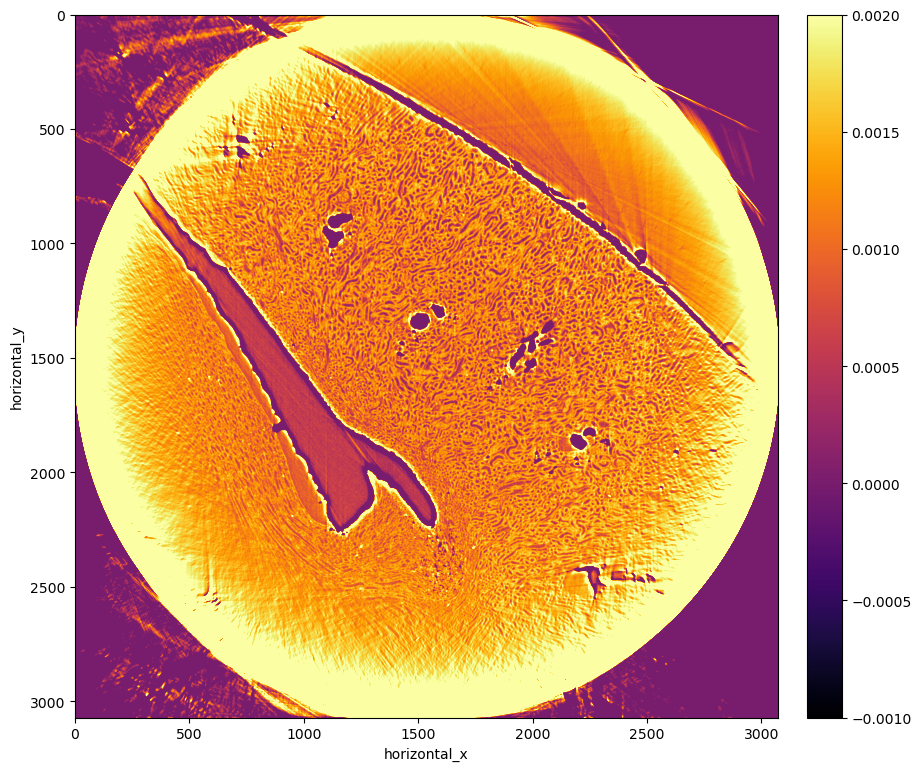

In [106]:
show2D(myFISTANN.solution, 
      cmap='inferno', fix_range=(-0.001,0.002), origin='upper-left')

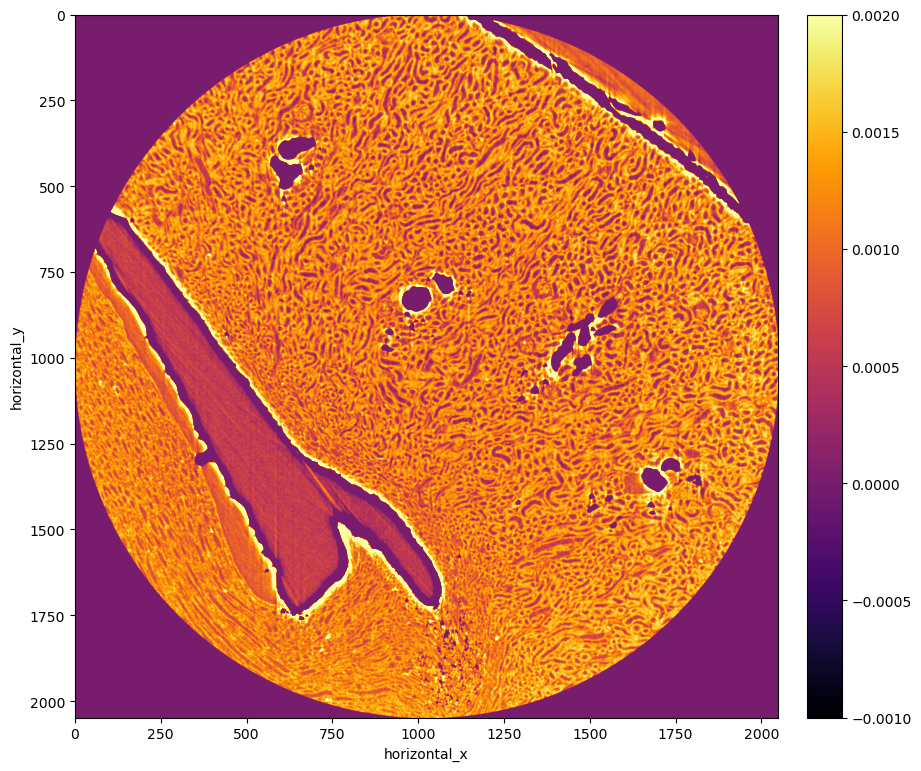

In [107]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTANN.solution)



fista_recon = im_crop * a

show2D(fista_recon, 
      cmap='inferno', fix_range=(-0.001,0.002), origin='upper-left')

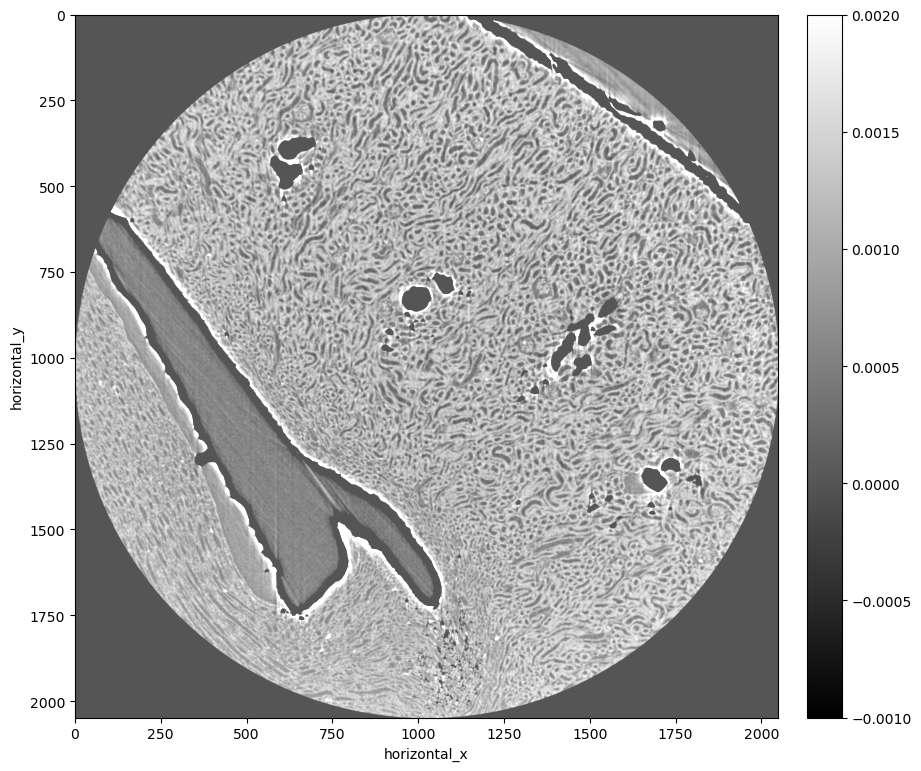

In [108]:
show2D(fista_recon, 
      cmap='gray', fix_range=(ca1,ca2), origin='upper-left')

## Use FISTA to solve a Least Squares problem with Total Variation regularisation

In [128]:
#Import Total Variation from the regularisation toolkit plugin
from cil.plugins.ccpi_regularisation.functions import FGP_TV

In [129]:
# Run 200 iterations of `myFISTATV` with:
alpha=0.02

In [130]:
GTV = alpha*FGP_TV(device='gpu') 
myFISTATV = FISTA(f=F, 
                  g=GTV, 
                  initial=x0 ,
                  max_iteration=1000, 
                  update_objective_interval = 10)

Note that the proximal mapping of Total Variation is not simple but needs to be evaluated numerically, but this is handled by the `TotalVariation` and `FGP_TV` functions, however it does take a while to run which is why we use the `GPU` implementation on real data (approximately 3 minutes):

In [131]:
myFISTATV.run(5,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0       1000         0.000          9.94488e+07
-------------------------------------------------------
        5       1000         0.928                     
Stop criterion has been reached.



In [132]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_5 = im_crop * a

In [133]:
myFISTATV.run(5,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        5       1000         0.928                     
       10       1000         0.876          8.19820e+05
-------------------------------------------------------
       10       1000         0.876          8.19820e+05
Stop criterion has been reached.



In [134]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_10 = im_crop * a

In [135]:
myFISTATV.run(15,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       10       1000         0.876          8.19820e+05
       20       1000         0.850          5.19261e+05
-------------------------------------------------------
       25       1000         0.843                     
Stop criterion has been reached.



In [136]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_25 = im_crop * a

In [137]:
myFISTATV.run(25,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       25       1000         0.843                     
       30       1000         0.840          4.51705e+05
       40       1000         0.835          4.26361e+05
       50       1000         0.832          4.14046e+05
-------------------------------------------------------
       50       1000         0.832          4.14046e+05
Stop criterion has been reached.



In [138]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_50 = im_crop * a

In [139]:
myFISTATV.run(50,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       50       1000         0.832          4.14046e+05
       60       1000         0.830          4.07167e+05
       70       1000         0.829          4.02920e+05
       80       1000         0.828          4.00121e+05
       90       1000         0.827          3.98167e+05
      100       1000         0.827          3.96733e+05
-------------------------------------------------------
      100       1000         0.827          3.96733e+05
Stop criterion has been reached.



In [140]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_100 = im_crop * a

In [141]:
myFISTATV.run(100,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      100       1000         0.827          3.96733e+05
      110       1000         0.826          3.95638e+05
      120       1000         0.825          3.94776e+05
      130       1000         0.824          3.94084e+05
      140       1000         0.824          3.93520e+05
      150       1000         0.823          3.93054e+05
      160       1000         0.823          3.92666e+05
      170       1000         0.822          3.92338e+05
      180       1000         0.822          3.92059e+05
      190       1000         0.822          3.91818e+05
      200       1000         0.821          3.91609e+05
-------------------------------------------------------
      200       1000         0.821          3.91609e+05
Stop criterion has been reached.



In [142]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_200 = im_crop * a

In [143]:
myFISTATV.run(100,verbose=1)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      200       1000         0.821          3.91609e+05
      210       1000         0.821          3.91427e+05
      220       1000         0.820          3.91268e+05
      230       1000         0.820          3.91127e+05
      240       1000         0.820          3.91003e+05
      250       1000         0.820          3.90892e+05
      260       1000         0.819          3.90793e+05
      270       1000         0.819          3.90705e+05
      280       1000         0.819          3.90625e+05
      290       1000         0.819          3.90554e+05
      300       1000         0.819          3.90489e+05
-------------------------------------------------------
      300       1000         0.819          3.90489e+05
Stop criterion has been reached.



In [144]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

recon_fista_tv_300 = im_crop * a

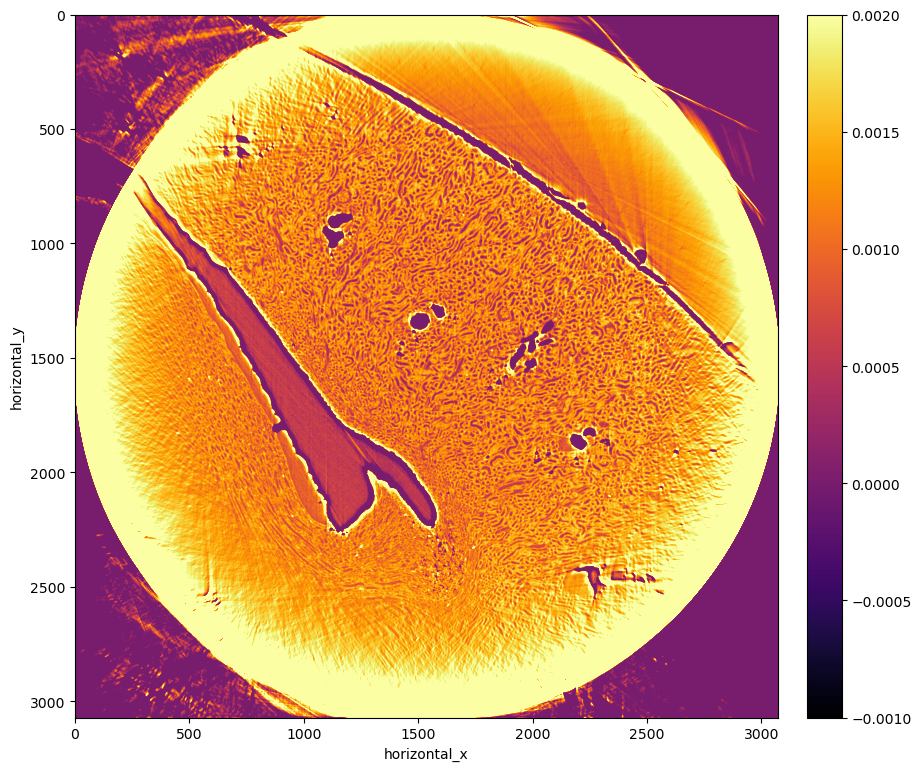

In [145]:
show2D(myFISTATV.solution, 
     cmap='inferno', fix_range=(ca1,ca2), origin='upper-left')

In [146]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(myFISTATV.solution)

fista_tv_recon = im_crop * a

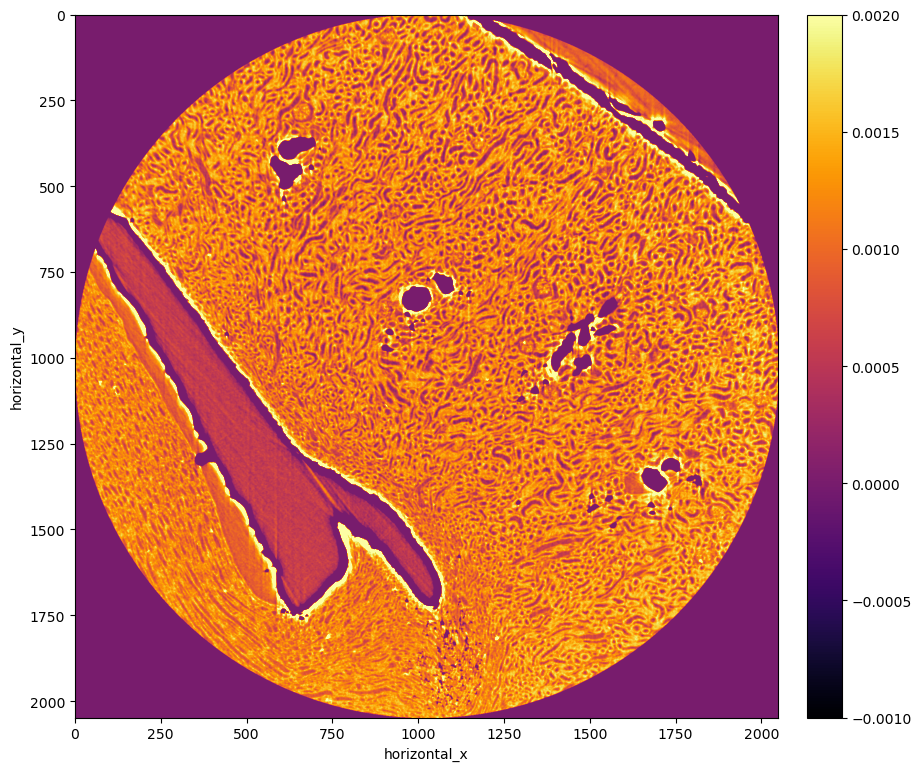

In [147]:
show2D(fista_tv_recon, 
     cmap='inferno', fix_range=(ca1,ca2), origin='upper-left')

## Tikhonov regularisation using CGLS and block framework

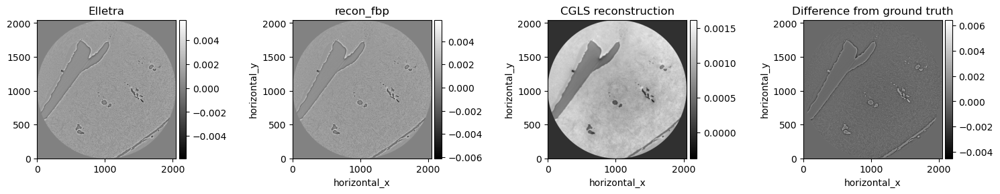

In [152]:
plots = [elletra, recon_fbp_mask_pad, cgls_recon, cgls_recon - elletra]
titles = ["Elletra", "recon_fbp", "CGLS reconstruction","Difference from ground truth" ]
#show2D(plots, titles, fix_range=[(ca1, ca2),(ca1,ca2)])
show2D(plots, titles, num_cols=4, cmap="gray")

Plot central vertical line profile of CGLS and ground truth:

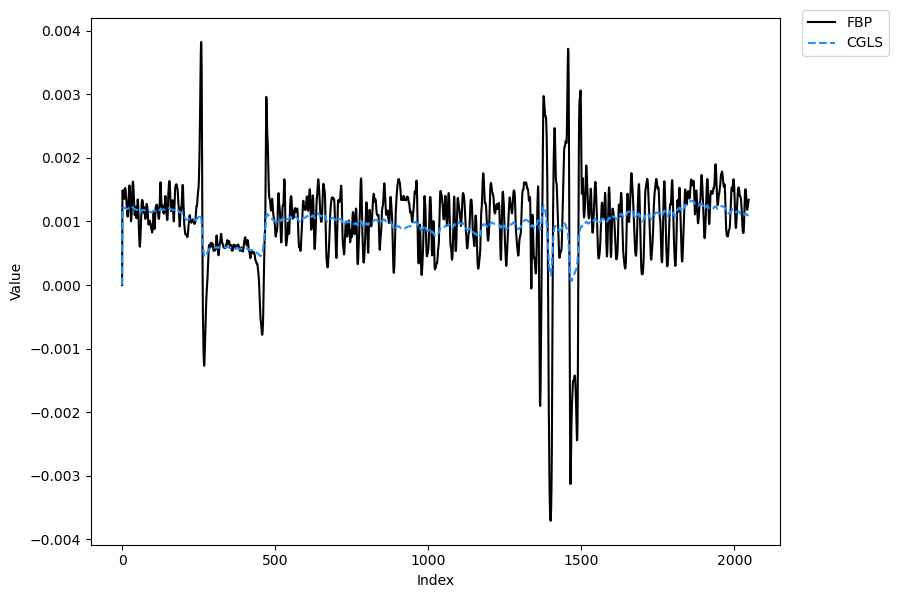

In [153]:
n = 2048
show1D([recon_fbp_mask_pad, cgls_recon],
       slice_list=[('horizontal_y',(n/2))],
       label=["FBP","CGLS"],
       line_colours=['black','dodgerblue'],
       line_styles=['solid','dashed'])

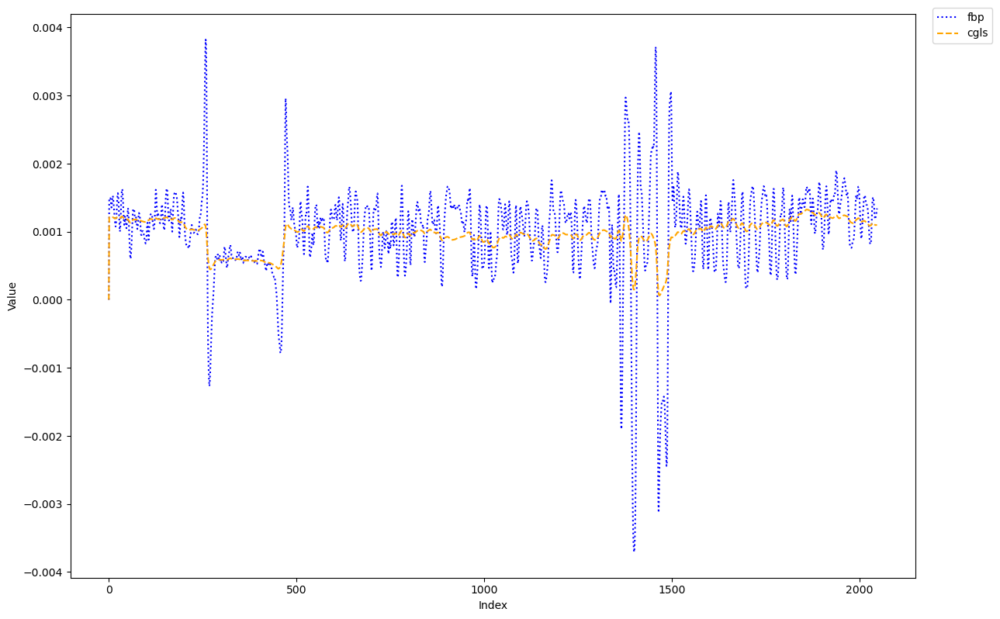

In [154]:
linenumy = 1024

show1D([recon_fbp_mask_pad, cgls_recon],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp','cgls'],
      line_colours=['blue','orange'],
      line_styles=['dotted','dashed'],
      size=(12,8))

In [155]:
L = IdentityOperator(ig_512)
alpha = 0.1

operator_block = BlockOperator(A_512, alpha*L)

In [156]:
zero_data = L.range.allocate(0)

data_block = BlockDataContainer(data_pad_512, zero_data)

In [157]:
#setup CGLS with the Block Operator and Block DataContainer
initial = ig_512.allocate(0)      
cgls_tikh = CGLS(initial=initial, operator=operator_block, data=data_block, update_objective_interval = 10)
cgls_tikh.max_iteration = 1000

In [158]:
#run the algorithm
cgls_tikh.run(5)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        0       1000         0.000          9.94488e+07
-------------------------------------------------------
        5       1000         0.768                     
Stop criterion has been reached.



In [159]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_5 = im_crop * a

In [160]:
#run the algorithm
cgls_tikh.run(5)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
        5       1000         0.768                     
       10       1000         0.747          4.34553e+05
-------------------------------------------------------
       10       1000         0.747          4.34553e+05
Stop criterion has been reached.



In [161]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_10 = im_crop * a

In [162]:
#run the algorithm
cgls_tikh.run(15)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       10       1000         0.747          4.34553e+05
       20       1000         0.734          3.82442e+05
-------------------------------------------------------
       25       1000         0.729                     
Stop criterion has been reached.



In [163]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_25 = im_crop * a

In [164]:
#run the algorithm
cgls_tikh.run(25)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       25       1000         0.729                     
       30       1000         0.727          3.71492e+05
       40       1000         0.723          3.67178e+05
       50       1000         0.720          3.64645e+05
-------------------------------------------------------
       50       1000         0.720          3.64645e+05
Stop criterion has been reached.



In [165]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_50 = im_crop * a

In [166]:
#run the algorithm
cgls_tikh.run(50)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
       50       1000         0.720          3.64645e+05
       60       1000         0.720          3.62960e+05
       70       1000         0.719          3.61786e+05
       80       1000         0.718          3.60875e+05
       90       1000         0.716          3.60062e+05
      100       1000         0.715          3.59394e+05
-------------------------------------------------------
      100       1000         0.715          3.59394e+05
Stop criterion has been reached.



In [167]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_100 = im_crop * a

In [168]:
#run the algorithm
cgls_tikh.run(100)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      100       1000         0.715          3.59394e+05
      110       1000         0.715          3.58777e+05
      120       1000         0.715          3.58241e+05
      130       1000         0.715          3.57713e+05
      140       1000         0.714          3.57258e+05
      150       1000         0.714          3.56705e+05
      160       1000         0.714          3.56219e+05
      170       1000         0.714          3.55701e+05
      180       1000         0.714          3.55182e+05
      190       1000         0.714          3.54668e+05
      200       1000         0.714          3.54175e+05
-------------------------------------------------------
      200       1000         0.714          3.54175e+05
Stop criterion has been reached.



In [169]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_200 = im_crop * a

In [170]:
#run the algorithm
cgls_tikh.run(100)

     Iter   Max Iter     Time/Iter            Objective
                               [s]                     
      200       1000         0.714          3.54175e+05
      210       1000         0.714          3.53647e+05
      220       1000         0.714          3.53126e+05
      230       1000         0.714          3.52536e+05
      240       1000         0.714          3.51884e+05
      250       1000         0.713          3.51164e+05
      260       1000         0.713          3.50513e+05
      270       1000         0.713          3.49784e+05
      280       1000         0.713          3.49111e+05
      290       1000         0.712          3.48404e+05
      300       1000         0.712          3.47624e+05
-------------------------------------------------------
      300       1000         0.712          3.47624e+05
Stop criterion has been reached.



In [171]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



recon_cgls_tikh_300 = im_crop * a

In [172]:
im_crop = Slicer(roi={'horizontal_y':(512,2560,1),
                     'horizontal_x':(512,2560,1)})(cgls_tikh.solution)



cgls_tikh_recon = im_crop * a

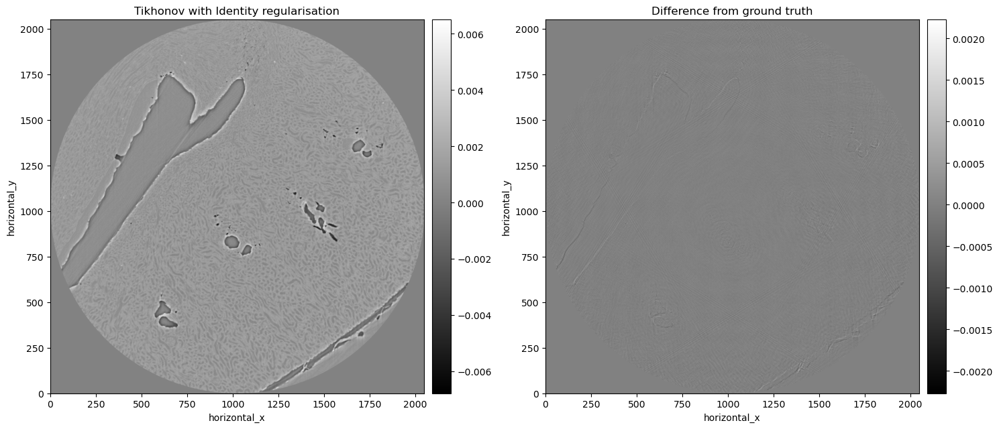

In [173]:
plots = [cgls_tikh_recon, cgls_tikh_recon - recon_fbp_mask_pad]
titles = ["Tikhonov with Identity regularisation","Difference from ground truth" ]
#show2D(plots, titles, fix_range=[(-0.2,1.2),(-0.2,0.2)])
show2D(plots, titles, num_cols=2, cmap="gray")

Let's compare the reconstructions from CGLS and Tikhonov with identity regularisation.

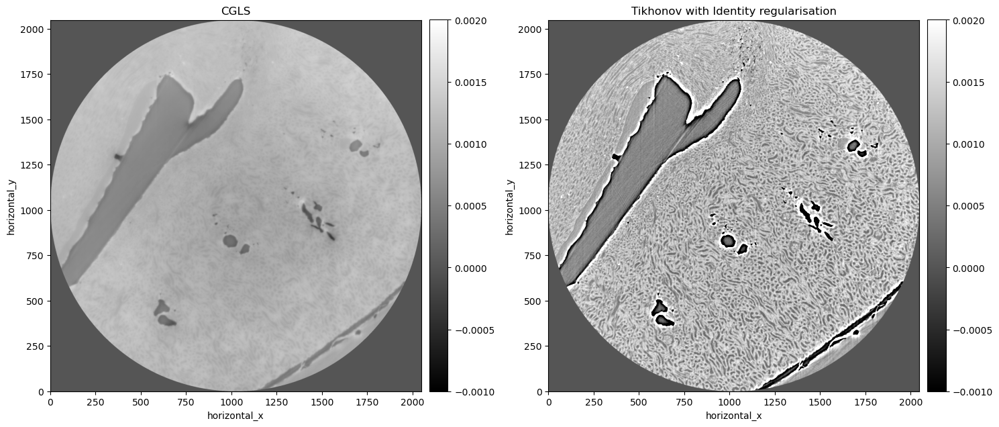

In [174]:
plots = [cgls_recon, cgls_tikh_recon]
titles = ["CGLS", "Tikhonov with Identity regularisation" ]
show2D(plots, titles, fix_range=(ca1,ca2))
#show2D(plots, titles)

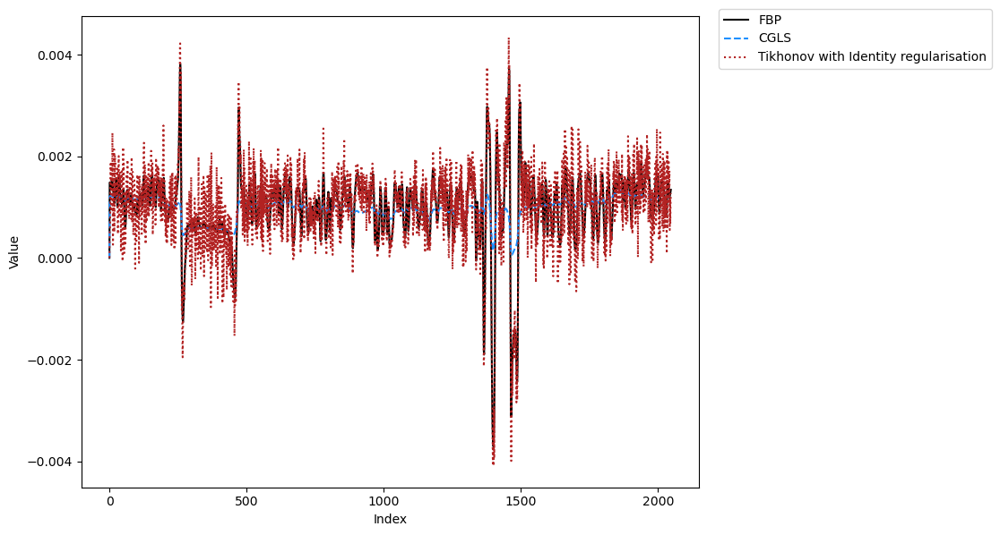

In [175]:
n = 2048
show1D([recon_fbp_mask_pad, cgls_recon, cgls_tikh_recon],
       slice_list=[("horizontal_y",n/2)],
       label=["FBP","CGLS","Tikhonov with Identity regularisation"],
       line_colours=['black','dodgerblue','firebrick'],
       line_styles=['solid','dashed','dotted'])

## Figures, line profiles and comparisons

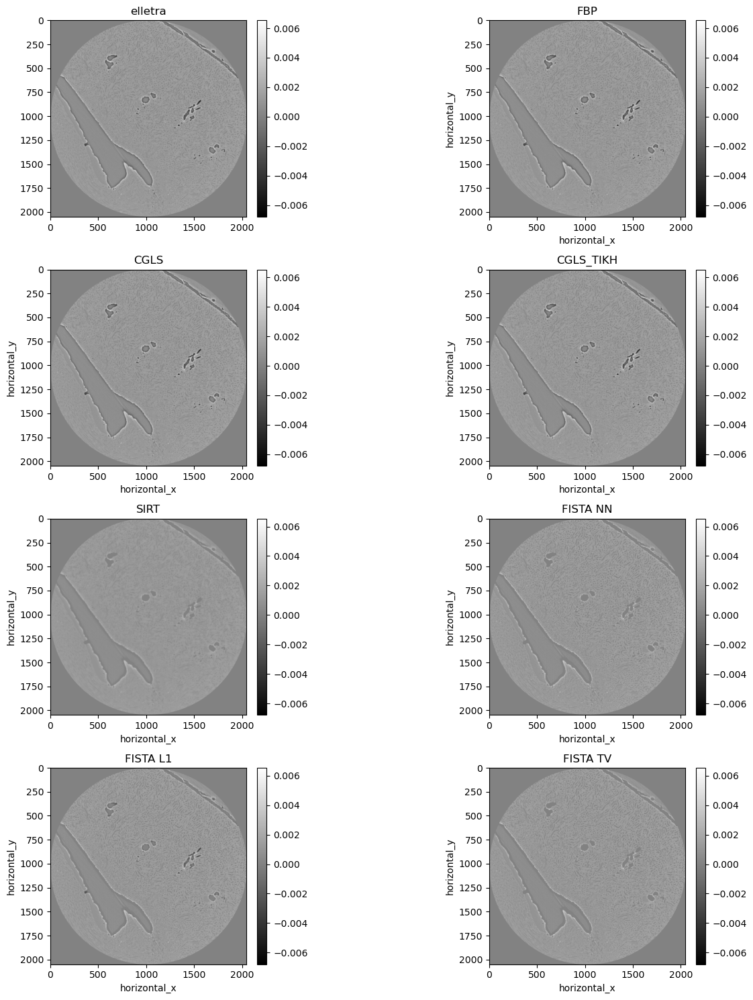

In [177]:
show2D([elletra, recon_fbp_mask_pad, recon_cgls_mask_pad, recon_cgls_tikh_100, recon_sirt_mask, recon_fista_nn_100, recon_fista_l1_100, recon_fista_tv_100], \
       ['elletra', 'FBP', 'CGLS', 'CGLS_TIKH', 'SIRT', 'FISTA NN', 'FISTA L1', 'FISTA TV'], \
       cmap=cmap, num_cols=2, size=(15,15), origin='upper-left', fix_range=True)

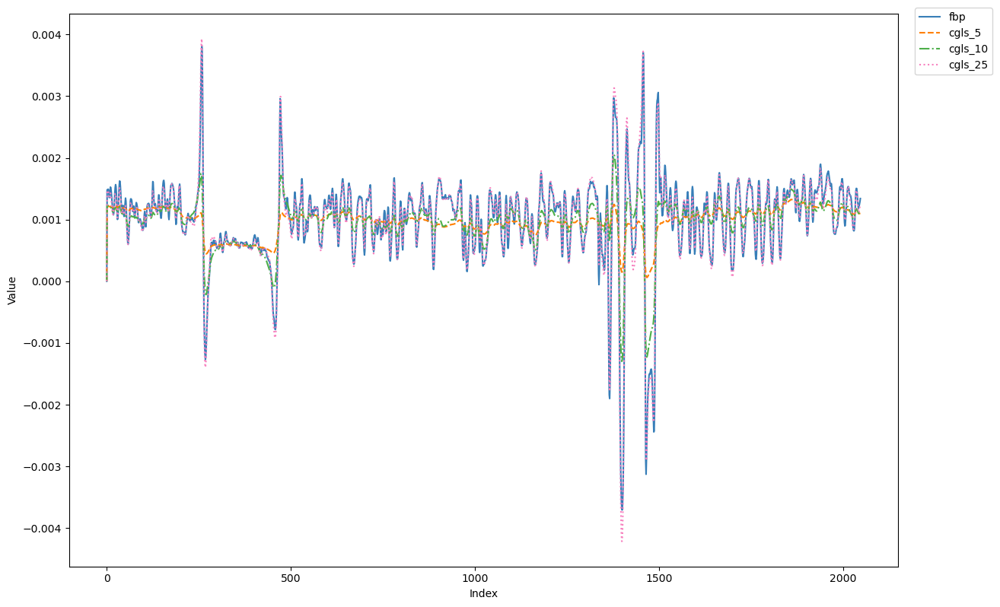

In [187]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_cgls_5, recon_cgls_10, recon_cgls_25],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp','cgls_5', 'cgls_10','cgls_25'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

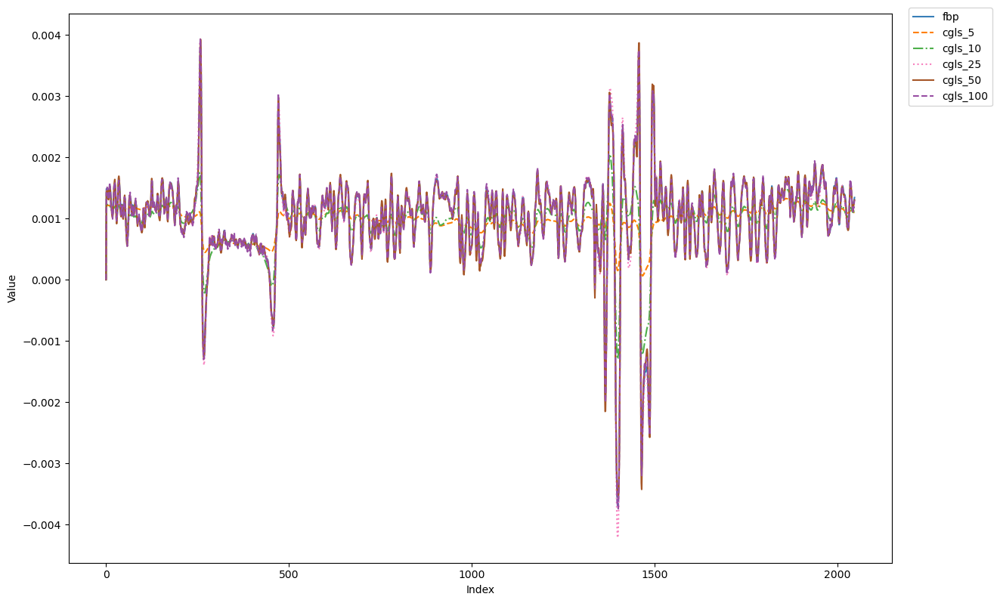

In [178]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_cgls_5, recon_cgls_10, recon_cgls_25, recon_cgls_50, recon_cgls_100],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp','cgls_5', 'cgls_10','cgls_25','cgls_50','cgls_100'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

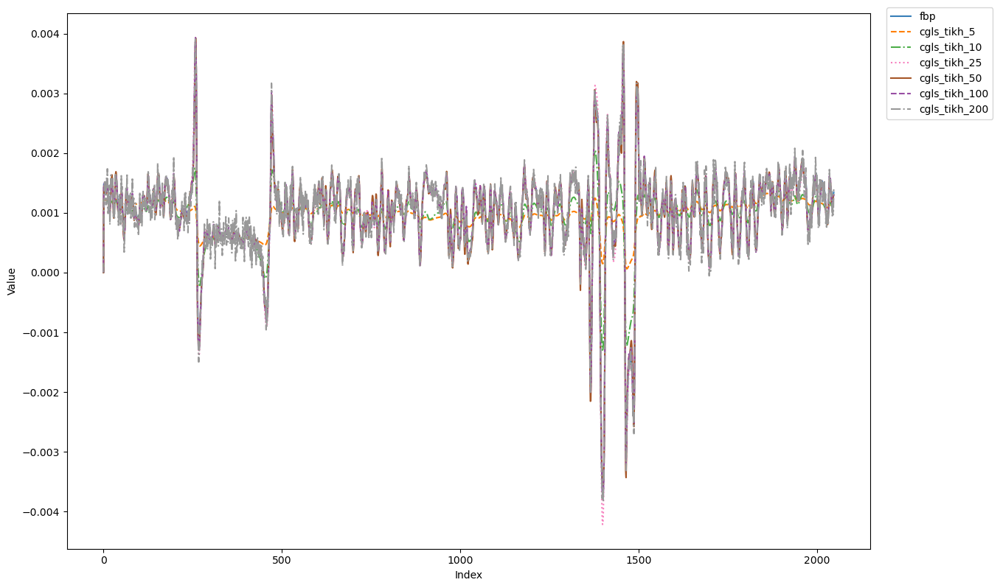

In [200]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_cgls_tikh_5, recon_cgls_tikh_10, recon_cgls_tikh_25, recon_cgls_tikh_50, recon_cgls_tikh_100, recon_cgls_tikh_200],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp', 'cgls_tikh_5', 'cgls_tikh_10','cgls_tikh_25','cgls_tikh_50','cgls_tikh_100', 'cgls_tikh_200'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

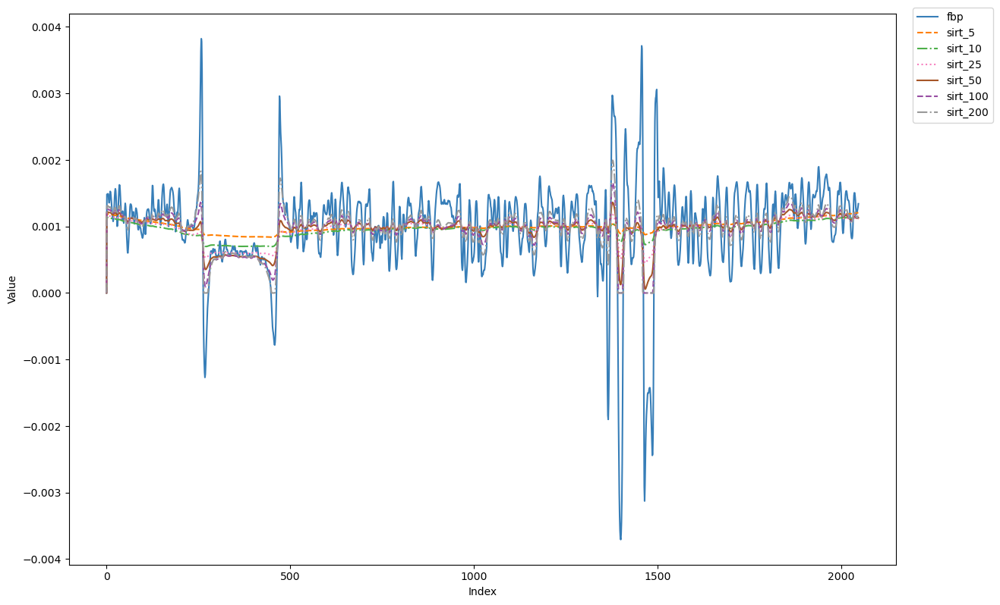

In [190]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_sirt_5, recon_sirt_10, recon_sirt_25, recon_sirt_50, recon_sirt_100, recon_sirt_200],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp','sirt_5', 'sirt_10','sirt_25','sirt_50','sirt_100', 'sirt_200'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

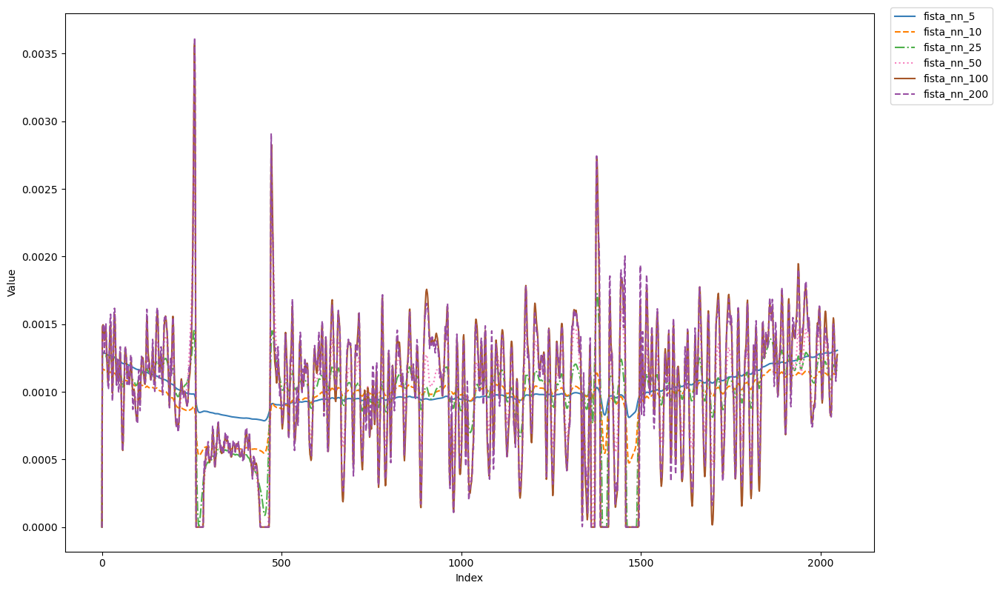

In [193]:
linenumy = 1024

show1D([recon_fista_nn_5, recon_fista_nn_10, recon_fista_nn_25, recon_fista_nn_50, recon_fista_nn_100, recon_fista_nn_200],
       slice_list=[('horizontal_y',linenumy)],
       label=['fista_nn_5', 'fista_nn_10','fista_nn_25','fista_nn_50','fista_nn_100', 'fista_nn_200'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

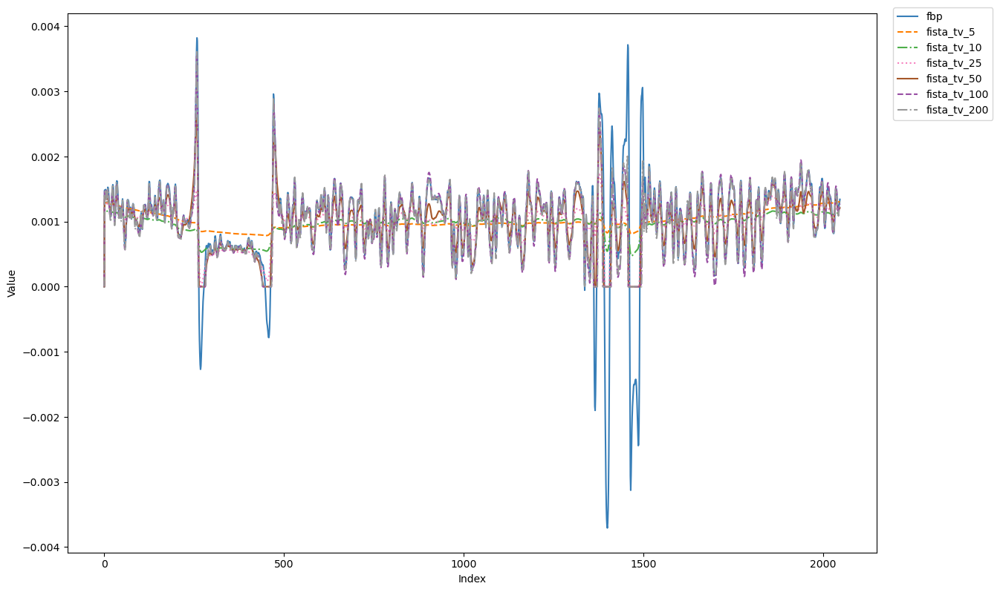

In [196]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_fista_tv_5, recon_fista_tv_10, recon_fista_tv_25, recon_fista_tv_50, recon_fista_tv_100, recon_fista_tv_200],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp', 'fista_tv_5', 'fista_tv_10','fista_tv_25','fista_tv_50','fista_tv_100', 'fista_tv_200'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

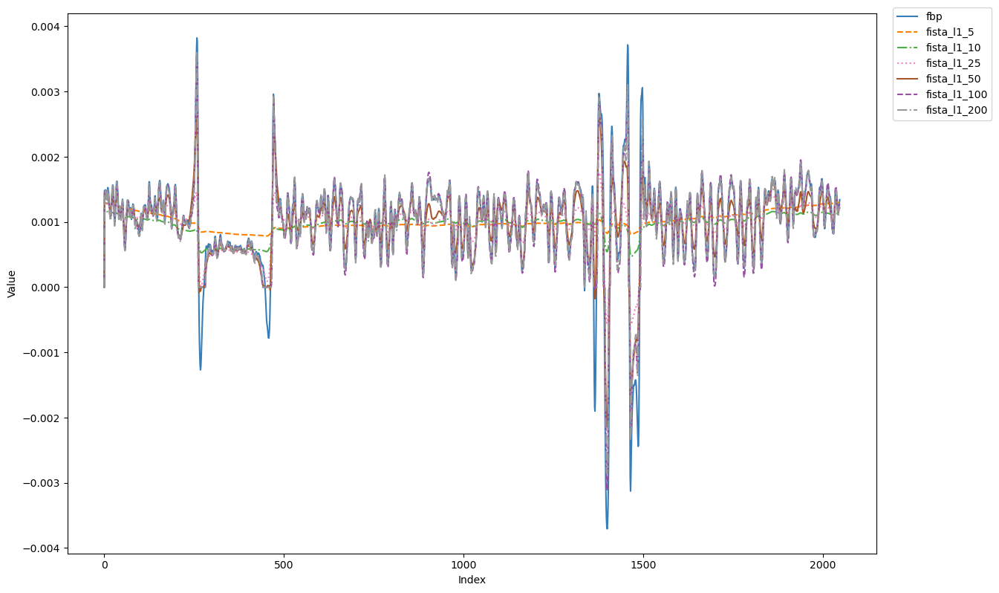

In [197]:
linenumy = 1024

show1D([recon_fbp_mask_pad, recon_fista_l1_5, recon_fista_l1_10, recon_fista_l1_25, recon_fista_l1_50, recon_fista_l1_100, recon_fista_l1_200],
       slice_list=[('horizontal_y',linenumy)],
       label=['fbp', 'fista_l1_5', 'fista_l1_10','fista_l1_25','fista_l1_50','fista_l1_100', 'fista_l1_200'],
      #line_colours=['blue','orange'],
      #line_styles=['dotted','dashed'],
      size=(12,8))

## Convergence of the algorithms

CIL Algorithms can record history of objective values (primal and dual for PDHG) for monitoring convergence:

Text(0, 0.5, 'Objective value')

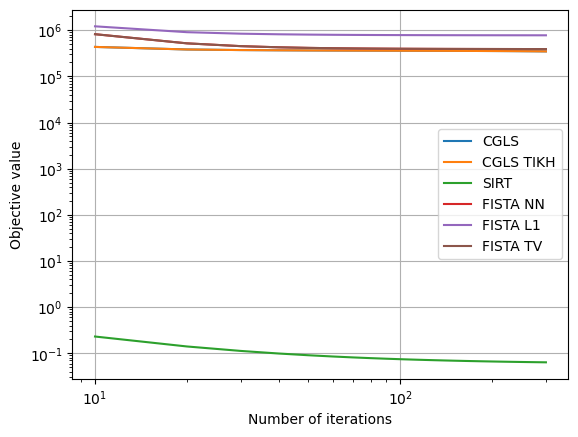

In [179]:
plt.figure()
plt.loglog(myCGLS.iterations[1:], myCGLS.objective[1:])
plt.loglog(cgls_tikh.iterations[1:], cgls_tikh.objective[1:])
plt.loglog(sirt.iterations[1:], sirt.objective[1:])
plt.loglog(myFISTANN.iterations[1:], myFISTANN.objective[1:])
plt.loglog(myFISTAL1.iterations[1:], myFISTAL1.objective[1:])
plt.loglog(myFISTATV.iterations[1:], myFISTATV.objective[1:])

#plt.ylim((1e-2,1e7))
plt.legend(['CGLS', 'CGLS TIKH', 'SIRT', 'FISTA NN', 'FISTA L1', 'FISTA TV'])
plt.grid()
plt.xlabel('Number of iterations')
plt.ylabel('Objective value')

Text(0, 0.5, 'Objective value')

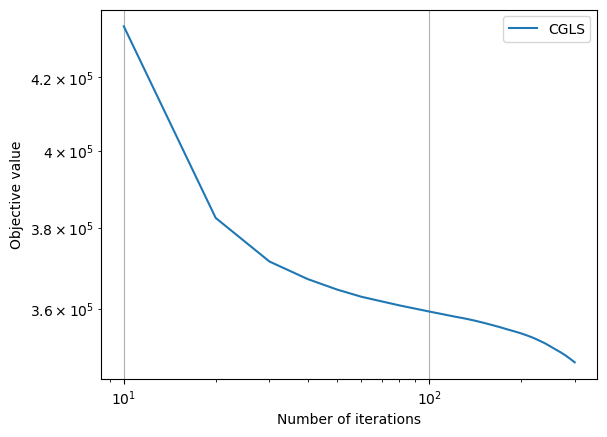

In [180]:
plt.figure()
plt.loglog(myCGLS.iterations[1:], myCGLS.objective[1:])
#plt.loglog(cgls_tikh.iterations[1:], cgls_tikh.objective[1:])
#plt.loglog(sirt.iterations[1:], sirt.objective[1:])
#plt.loglog(myFISTANN.iterations[1:], myFISTANN.objective[1:])
#plt.loglog(myFISTAL1.iterations[1:], myFISTAL1.objective[1:])
#plt.loglog(myFISTATV.iterations[1:], myFISTATV.objective[1:])

#plt.ylim((1e-2,1e7))
plt.legend(['CGLS'])
plt.grid()
plt.xlabel('Number of iterations')
plt.ylabel('Objective value')

Text(0, 0.5, 'Objective value')

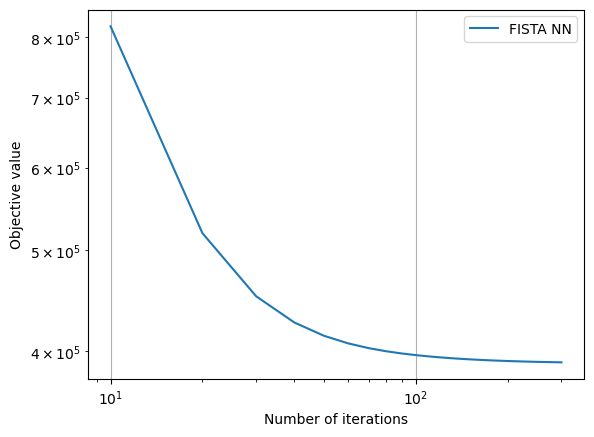

In [181]:
plt.figure()
#plt.loglog(myCGLS.iterations[1:], myCGLS.objective[1:])
#plt.loglog(cgls_tikh.iterations[1:], cgls_tikh.objective[1:])
#plt.loglog(sirt.iterations[1:], sirt.objective[1:])
plt.loglog(myFISTANN.iterations[1:], myFISTANN.objective[1:])
#plt.loglog(myFISTAL1.iterations[1:], myFISTAL1.objective[1:])
#plt.loglog(myFISTATV.iterations[1:], myFISTATV.objective[1:])

#plt.ylim((1e-2,1e7))
plt.legend(['FISTA NN'])
plt.grid()
plt.xlabel('Number of iterations')
plt.ylabel('Objective value')